In [1]:
import sdmetrics

print(sdmetrics.__version__)

0.17.0


In [2]:
import json

# Metadata dictionary
metadata = {
    "primary_key": "Index",
    "columns": {
        "age": {
            "sdtype": "numerical",
            "compute_representation": "Float"
        },
        "sex": {
            "sdtype": "categorical"
        },
        "marital_status": {
            "sdtype": "categorical"
        },
        "education": {
            "sdtype": "categorical"
        },
        "occupation": {
            "sdtype": "categorical"
        },
        "fu_disposition_pod": {
            "sdtype": "numerical",
            "compute_representation": "Float"
        },
        "i_seatbelt": {
            "sdtype": "categorical"
        },
        "gcs_qualifier": {
            "sdtype": "categorical"
        },
        "breath": {
            "sdtype": "categorical"
        },
        "i_carseat": {
            "sdtype": "categorical"
        },
        "respirations": {
            "sdtype": "numerical",
            "compute_representation": "Float"
        },
        "tempcontrol": {
            "sdtype": "categorical"
        },
        "i_helmet": {
            "sdtype": "categorical"
        },
        "scenecare": {
            "sdtype": "categorical"
        },
        "trachealdeviation": {
            "sdtype": "categorical"
        },
        "traveldistance": {
            "sdtype": "numerical",
            "compute_representation": "Float"
        },
        "cable": {
            "sdtype": "categorical"
        },
        "priorcare": {
            "sdtype": "categorical"
        },
        "phq_depression_2": {
            "sdtype": "categorical"
        },
        "pupils": {
            "sdtype": "categorical"
        },
        "dispo_costcareimpede": {
            "sdtype": "categorical"
        },
        "mixer": {
            "sdtype": "categorical"
        },
        "vitals1_dbp": {
            "sdtype": "numerical",
            "compute_representation": "Float"
        },
        "i_alcohol_perpretrator": {
            "sdtype": "categorical"
        },
        "i_overloading": {
            "sdtype": "categorical"
        },
        "dispo_cost": {
            "sdtype": "numerical",
            "compute_representation": "Float"
        },
        "treat_crystalloidvol": {
            "sdtype": "numerical",
            "compute_representation": "Float"
        },
        "fu_cryst_volume": {
            "sdtype": "numerical",
            "compute_representation": "Float"
        },
        "fu_obsrv_exam": {
            "sdtype": "categorical"
        },
        "tetanus_wound": {
            "sdtype": "categorical"
        },
        "fu_total_cost": {
            "sdtype": "numerical",
            "compute_representation": "Float"
        },
        "i_intent": {
            "sdtype": "categorical"
        },
        "tetanus": {
            "sdtype": "categorical"
        },
        "i_activity": {
            "sdtype": "categorical"
        },
        "fu_disposition_hd": {
            "sdtype": "numerical",
            "compute_representation": "Float"
        },
        "chestrise": {
            "sdtype": "categorical"
        },
        "airway": {
            "sdtype": "categorical"
        },
        "emergency_finassist": {
            "sdtype": "categorical"
        },
        "pregnant": {
            "sdtype": "categorical"
        },
        "alcoholuse": {
            "sdtype": "categorical"
        },
        "phq_depression": {
            "sdtype": "categorical"
        },
        "prior_injury": {
            "sdtype": "categorical"
        },
        "tv": {
            "sdtype": "categorical"
        },
        "i_airbag": {
            "sdtype": "categorical"
        },
        "tobaccouse": {
            "sdtype": "categorical"
        },
        "transfer": {
            "sdtype": "categorical"
        },
        "vitals1_hr": {
            "sdtype": "numerical",
            "compute_representation": "Float"
        },
        "vitals1_sbp": {
            "sdtype": "numerical",
            "compute_representation": "Float"
        },
        "i_alcohol_patient": {
            "sdtype": "categorical"
        }
    }
}



In [3]:
import pandas as pd

df = pd.read_csv("true_data_subset.csv")
df.drop(["site_id","record_id"], axis=1, inplace=True)

# df_test is a 20% random sample of the real data
df_test = df.sample(frac=0.2)

# df_real is the remaining 80% of the real data
df_real = df.drop(df_test.index)

# class_cat_col defined as columns with less than 10 unique values

class_cat_col = [col for col in df.columns if df[col].nunique() < 30]

print(class_cat_col)


df_fake = pd.read_csv("synthetic_data_subset.csv")
df_fake_R = pd.read_csv("synthetic_data_R.csv")
# convert all to numeric float64
df_fake = df_fake.apply(pd.to_numeric, errors='coerce').astype('float64')
df_fake_R = df_fake_R.apply(pd.to_numeric, errors='coerce').astype('float64')
# drop "Unnamed: 0" and "unmatched" columns from the synthetic data
df_fake.drop(["Unnamed: 0", "unmatched","site_id","record_id"], axis=1, inplace=True)

# print column names of the synthetic data

print(df_fake.columns)
print(df_real.columns)

# check if the columns in the synthetic data are the same as the real data and find the difference

print(set(df_fake.columns) - set(df_real.columns))
print(set(df_fake_R.columns) - set(df_real.columns))

# for all columns of categorical data, treat missing as a separate category

for col in class_cat_col:
    df_fake[col] = df_fake[col].fillna(99.0)
    df_real[col] = df_real[col].fillna(99.0)
    df_test[col] = df_test[col].fillna(99.0)
    df_fake_R[col] = df_fake_R[col].fillna(99.0)

# for all columns of numerical data, fill missing values with the mean of the column

for col in df_fake.columns:
    if col not in class_cat_col:
        df_fake[col] = df_fake[col].fillna(df_fake[col].mean())
        df_real[col] = df_real[col].fillna(df_real[col].mean())
        df_test[col] = df_test[col].fillna(df_test[col].mean())
        df_fake_R[col] = df_fake_R[col].fillna(df_fake_R[col].mean())


# check if there are any missing values left

print(df_fake.isnull().sum().sum())
print(df_fake_R.isnull().sum().sum())
print(df_real.isnull().sum().sum())
print(df_test.isnull().sum().sum())

# check type of data in each column for df_fake and df_fake_R

print(df_fake.dtypes)
print(df_fake_R.dtypes)

['sex', 'marital_status', 'education', 'occupation', 'i_seatbelt', 'gcs_qualifier', 'breath', 'i_carseat', 'respirations', 'tempcontrol', 'i_helmet', 'scenecare', 'trachealdeviation', 'cable', 'priorcare', 'phq_depression_2', 'pupils', 'dispo_costcareimpede', 'mixer', 'i_alcohol_perpretrator', 'i_overloading', 'treat_crystalloidvol', 'fu_obsrv_exam', 'tetanus_wound', 'i_intent', 'tetanus', 'i_activity', 'chestrise', 'airway', 'emergency_finassist', 'pregnant', 'alcoholuse', 'phq_depression', 'prior_injury', 'tv', 'i_airbag', 'tobaccouse', 'transfer', 'i_alcohol_patient']
Index(['age', 'sex', 'marital_status', 'education', 'occupation',
       'fu_disposition_pod', 'i_seatbelt', 'gcs_qualifier', 'breath',
       'i_carseat', 'respirations', 'tempcontrol', 'i_helmet', 'scenecare',
       'trachealdeviation', 'traveldistance', 'cable', 'priorcare',
       'phq_depression_2', 'pupils', 'dispo_costcareimpede', 'mixer',
       'vitals1_dbp', 'i_alcohol_perpretrator', 'i_overloading', 'dispo_

In [4]:
from sdmetrics.reports.single_table import DiagnosticReport

diagnostic = DiagnosticReport()
diagnostic.generate(df_real, df_fake_R, metadata)

Generating report ...

(1/2) Evaluating Data Validity: |██████████| 49/49 [00:00<00:00, 4894.75it/s]|
Data Validity Score: 100.0%

(2/2) Evaluating Data Structure: |██████████| 1/1 [00:00<00:00, 500.04it/s]|
Data Structure Score: 96.0%

Overall Score (Average): 98.0%



In [5]:
validity_details = diagnostic.get_details('Data Validity')
validity_details.head(50)

,Column,Metric,Score
0,age,BoundaryAdherence,1.000000
1,sex,CategoryAdherence,1.000000
2,marital_status,CategoryAdherence,1.000000
3,education,CategoryAdherence,1.000000
4,occupation,CategoryAdherence,1.000000
5,fu_disposition_pod,BoundaryAdherence,1.000000
6,i_seatbelt,CategoryAdherence,1.000000
7,gcs_qualifier,CategoryAdherence,1.000000
8,breath,CategoryAdherence,1.000000
9,i_carseat,CategoryAdherence,1.000000


In [6]:
from sdmetrics.reports.single_table import QualityReport

quality_report = QualityReport()
quality_report.generate(df_real, df_fake_R, metadata)

Generating report ...

(1/2) Evaluating Column Shapes: |██████████| 49/49 [00:00<00:00, 632.56it/s]|
Column Shapes Score: 95.99%

(2/2) Evaluating Column Pair Trends: |██████████| 1176/1176 [00:02<00:00, 560.92it/s]|
Column Pair Trends Score: 96.68%

Overall Score (Average): 96.34%



In [7]:
quality_report.get_visualization('Column Pair Trends')

In [8]:
from sdmetrics.single_table import CategoricalKNN

CategoricalKNN.compute(
    real_data=df_real,
    synthetic_data=df_fake_R,
    key_fields=['age', 'sex','occupation'],
    sensitive_fields=['tobaccouse']
)

c:\Users\Junzhe Shao\anaconda3\envs\llm\Lib\site-packages\sklearn\neighbors\_classification.py:238: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

c:\Users\Junzhe Shao\anaconda3\envs\llm\Lib\site-packages\sklearn\base.py:493: UserWarning:

X does not have valid feature names, but OneHotEncoder was fitted with feature names

c:\Users\Junzhe Shao\anaconda3\envs\llm\Lib\site-packages\sklearn\base.py:493: UserWarning:

X does not have valid feature names, but OneHotEncoder was fitted with feature names

c:\Users\Junzhe Shao\anaconda3\envs\llm\Lib\site-packages\sklearn\base.py:493: UserWarning:

X does not have valid feature names, but OneHotEncoder was fitted with feature names

c:\Users\Junzhe Shao\anaconda3\envs\llm\Lib\site-packages\sklearn\base.py:493: UserWarning:

X does not have valid feature names, but OneHotEncoder was fitted with feature names

c:\Users\Junzhe Shao\anacon

0.15098039215686276

In [9]:
CategoricalKNN.compute(
    real_data=df_real,
    synthetic_data=df_fake,
    key_fields=['age', 'sex','occupation'],
    sensitive_fields=['tobaccouse']
)

c:\Users\Junzhe Shao\anaconda3\envs\llm\Lib\site-packages\sklearn\neighbors\_classification.py:238: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

c:\Users\Junzhe Shao\anaconda3\envs\llm\Lib\site-packages\sklearn\base.py:493: UserWarning:

X does not have valid feature names, but OneHotEncoder was fitted with feature names

c:\Users\Junzhe Shao\anaconda3\envs\llm\Lib\site-packages\sklearn\base.py:493: UserWarning:

X does not have valid feature names, but OneHotEncoder was fitted with feature names

c:\Users\Junzhe Shao\anaconda3\envs\llm\Lib\site-packages\sklearn\base.py:493: UserWarning:

X does not have valid feature names, but OneHotEncoder was fitted with feature names

c:\Users\Junzhe Shao\anaconda3\envs\llm\Lib\site-packages\sklearn\base.py:493: UserWarning:

X does not have valid feature names, but OneHotEncoder was fitted with feature names

c:\Users\Junzhe Shao\anacon

0.31176470588235294

In [ ]:
# now try to compute the metrics with any three columns as key fields, and any one column as sensitive field, repeat it for 30 times and get the average

import random
from sdmetrics.single_table import CategoricalKNN

results_llm = []
results_R = []
for i in range(30):
    # randomly select 3 columns as key fields
    key_fields = random.sample(df_real.columns.tolist(), 3)
    # randomly select 1 column as sensitive field
    sensitive_field = random.choice(df_real.columns.tolist())
    result_llm = CategoricalKNN.compute(
        real_data=df_real,
        synthetic_data=df_fake,
        key_fields=key_fields,
        sensitive_fields=[sensitive_field])
    results_llm.append(result_llm)

    result_R = CategoricalKNN.compute(
        real_data=df_real,
        synthetic_data=df_fake_R,
        key_fields=key_fields,
        sensitive_fields=[sensitive_field])
    results_R.append(result_R)



c:\Users\Junzhe Shao\anaconda3\envs\llm\Lib\site-packages\sklearn\neighbors\_classification.py:238: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

c:\Users\Junzhe Shao\anaconda3\envs\llm\Lib\site-packages\sklearn\base.py:493: UserWarning:

X does not have valid feature names, but OneHotEncoder was fitted with feature names

c:\Users\Junzhe Shao\anaconda3\envs\llm\Lib\site-packages\sklearn\base.py:493: UserWarning:

X does not have valid feature names, but OneHotEncoder was fitted with feature names

c:\Users\Junzhe Shao\anaconda3\envs\llm\Lib\site-packages\sklearn\base.py:493: UserWarning:

X does not have valid feature names, but OneHotEncoder was fitted with feature names

c:\Users\Junzhe Shao\anaconda3\envs\llm\Lib\site-packages\sklearn\base.py:493: UserWarning:

X does not have valid feature names, but OneHotEncoder was fitted with feature names

c:\Users\Junzhe Shao\anacon

[0.8495098039215686, 0.5833333333333333, 0.2671568627450981, 0.9514705882352941, 0.6372549019607843, 0.6901960784313725, 0.5122549019607843, 0.8862745098039215, 0.4019607843137255, 0.22843137254901957, 0.5455882352941177, 0.04166666666666663, 0.7151960784313726, 0.4852941176470589, 0.14068627450980398, 0.705392156862745, 0.23088235294117643, 0.5759803921568627, 0.6916666666666667, 0.6647058823529413, 0.08431372549019611, 0.8176470588235294, 0.2465686274509804, 0.7995098039215687, 0.207843137254902, 0.20294117647058818, 0.596078431372549, 0.8857843137254902, 0.9823529411764705, 0.7137254901960784]
0.5447222222222222
[0.6142156862745098, 0.5073529411764706, 0.263235294117647, 0.9151960784313725, 0.5524509803921569, 0.6299019607843137, 0.11274509803921573, 0.6436274509803921, 0.12696078431372548, 0.22156862745098038, 0.2691176470588236, 0.0004901960784313708, 0.40098039215686276, 0.4455882352941176, 0.06813725490196076, 0.5965686274509804, 0.19019607843137254, 0.5534313725490196, 0.516666

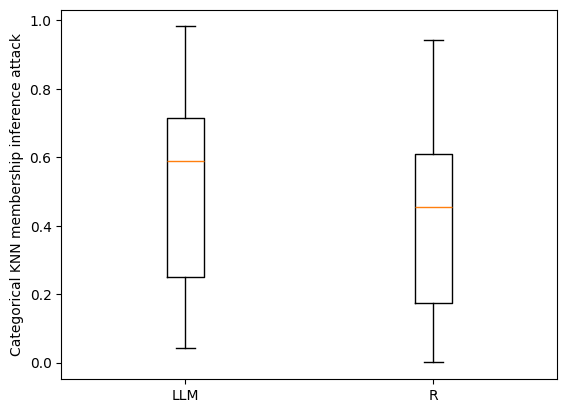

In [21]:
print(results_llm)
average_result_llm = sum(results_llm) / len(results_llm)
print(average_result_llm)

print(results_R)
average_result_R = sum(results_R) / len(results_R)
print(average_result_R)

# make a boxplot of the results

import matplotlib.pyplot as plt

plt.boxplot([results_llm, results_R])
plt.xticks([1, 2], ['LLM', 'R'])
plt.ylabel('Categorical KNN membership inference attack')
plt.show()
